In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import missingno as msno

from pycaret.classification import ClassificationExperiment
from pycaret.datasets import get_data

from ydata_profiling import ProfileReport

from explain.model import ModelExplainer

from sklearn.metrics import f1_score

In [2]:
data = get_data('data/diabetes')
data.head()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1


,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1


#### Dataset exploration

In [3]:
profile = ProfileReport(data, title="Pandas Profiling Report")
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

#### Auto-ML using pycaret

In [4]:
exp = ClassificationExperiment()
exp.setup(
    data,
    target='Outcome',
    session_id=42,
    n_jobs=1
)

,Description,Value
0,Session id,42
1,Target,Outcome
2,Target type,Binary
3,Original data shape,"(768, 9)"
4,Transformed data shape,"(768, 9)"
5,Transformed train set shape,"(537, 9)"
6,Transformed test set shape,"(231, 9)"
7,Numeric features,8
8,Preprocess,True
9,Imputation type,simple


In [5]:
best = exp.compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
lr,Logistic Regression,0.7784,0.8284,0.5819,0.7369,0.6397,0.4851,0.4994,0.0240
lda,Linear Discriminant Analysis,0.7784,0.8304,0.5819,0.7327,0.6395,0.4848,0.4977,0.0200
ridge,Ridge Classifier,0.7747,0.8306,0.5661,0.7344,0.6297,0.4740,0.4883,0.0160
nb,Naive Bayes,0.7599,0.8160,0.5930,0.6858,0.6275,0.4537,0.4616,0.0170
catboost,CatBoost Classifier,0.7579,0.8205,0.5664,0.6888,0.6118,0.4410,0.4526,1.0060
qda,Quadratic Discriminant Analysis,0.7525,0.8166,0.5775,0.6718,0.6149,0.4356,0.4424,0.0170
et,Extra Trees Classifier,0.7524,0.8100,0.5605,0.6824,0.5995,0.4275,0.4427,0.1030
gbc,Gradient Boosting Classifier,0.7449,0.8173,0.5398,0.6773,0.5874,0.4096,0.4239,0.1370
rf,Random Forest Classifier,0.7393,0.8114,0.5401,0.6601,0.5857,0.4005,0.4101,0.1170
ada,Ada Boost Classifier,0.7336,0.7854,0.5398,0.6396,0.5749,0.3865,0.3961,0.0890


In [6]:
exp.evaluate_model(best)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

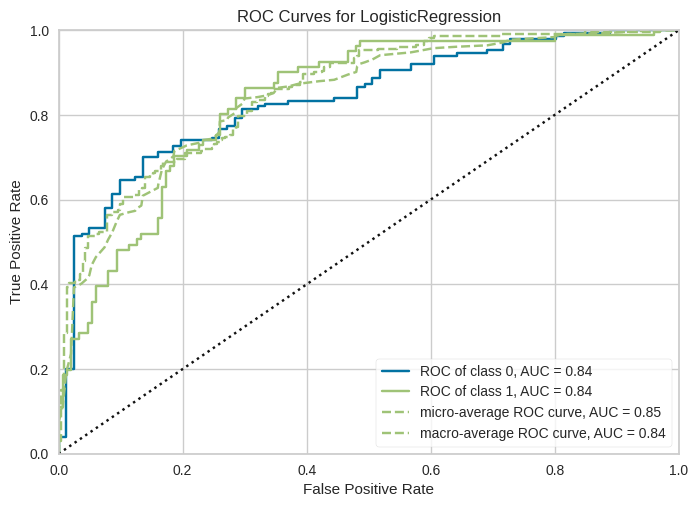

In [7]:
exp.plot_model(best, plot='auc')

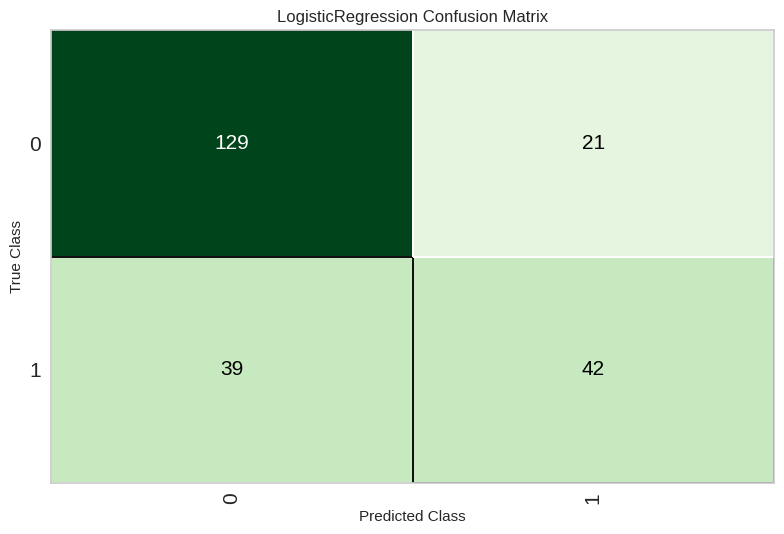

In [8]:
exp.plot_model(best, plot='confusion_matrix')

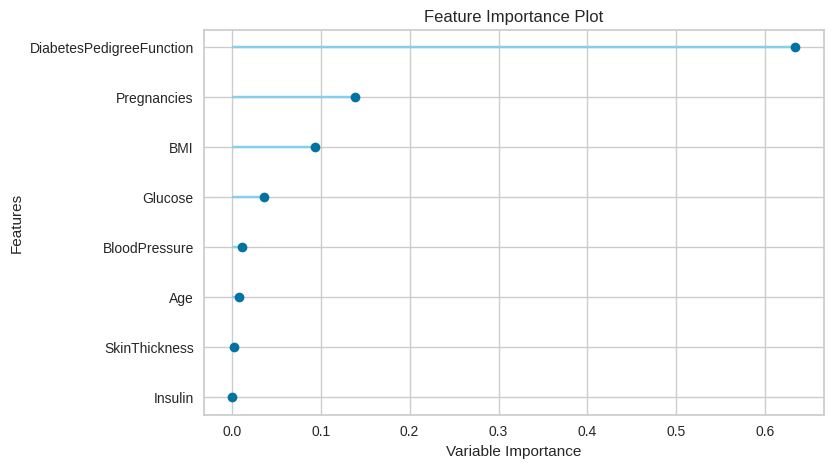

In [9]:
exp.plot_model(best, plot = 'feature')

#### Result interpretation using pycaret

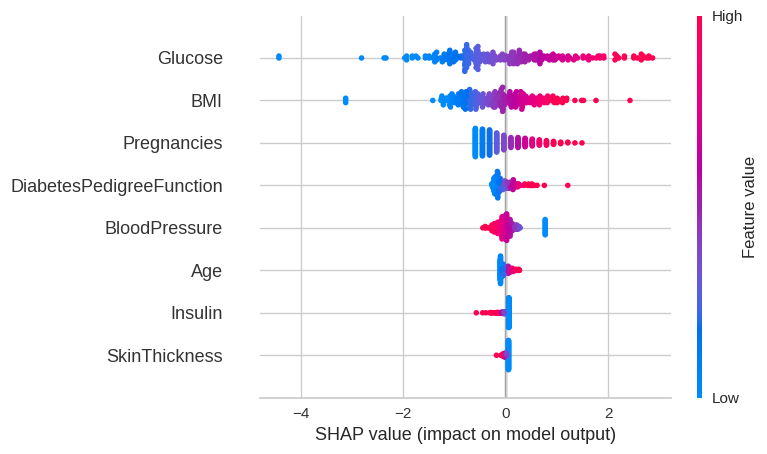

In [10]:
exp.interpret_model(best, plot = 'summary')

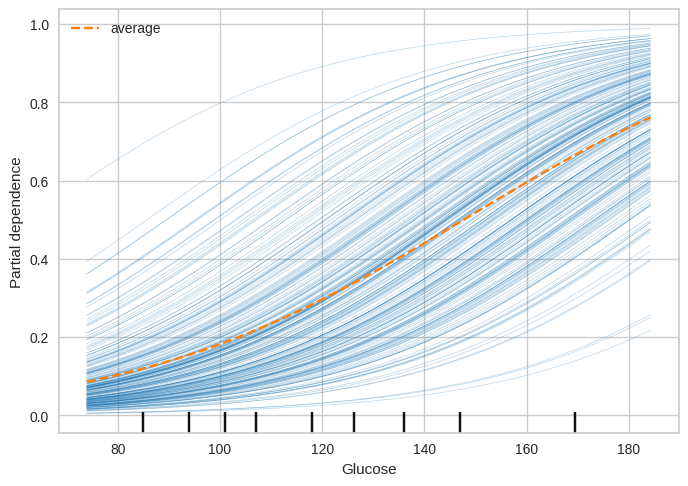

In [11]:
exp.interpret_model(best, plot = 'ice', feature='Glucose')

In [12]:
observation = data.drop(columns='Outcome').sample(1, random_state=40)
exp.interpret_model(best, plot = 'lime', observation=observation)

In [14]:
exp.interpret_model(best, plot = 'anchors', observation=observation)

#### Learning Curve: plot model score distributions against dataset size used for training

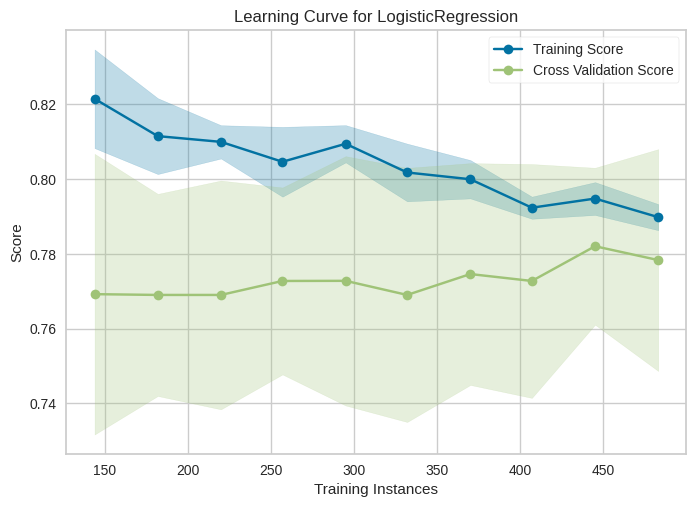

In [15]:
exp.plot_model(best, plot='learning')

### Experiment with spoiling the most important features

#### Make the values missing

In [16]:
data_missing = data.copy()
glucose_missing = 0.85
indexes = np.random.choice(data.index, int(len(data_missing) * glucose_missing), replace=False)
data_missing.loc[indexes, 'Glucose'] = None

<Axes: >

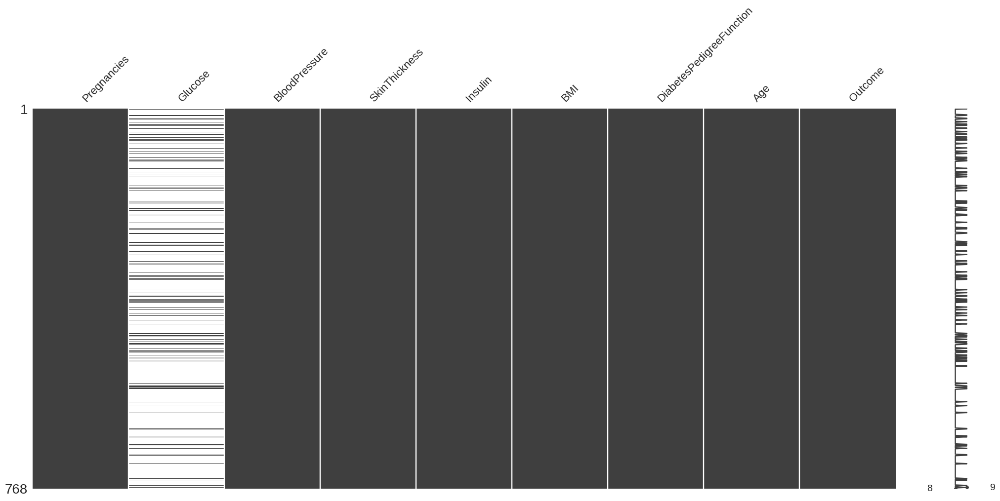

In [17]:
msno.matrix(data_missing)

In [18]:
profile = ProfileReport(data_missing, title="Pandas Profiling Report")
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [19]:
exp = ClassificationExperiment()
exp.setup(
    data_missing,
    target='Outcome',
    session_id=42,
    n_jobs=1,
    imputation_type='iterative',
    iterative_imputation_iters=20,
)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000015 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 134
[LightGBM] [Info] Number of data points in the train set: 80, number of used features: 7
[LightGBM] [Info] Start training from score 123.987500
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

,Description,Value
0,Session id,42
1,Target,Outcome
2,Target type,Binary
3,Original data shape,"(768, 9)"
4,Transformed data shape,"(768, 9)"
5,Transformed train set shape,"(537, 9)"
6,Transformed test set shape,"(231, 9)"
7,Numeric features,8
8,Rows with missing values,84.9%
9,Preprocess,True


In [20]:
best = exp.compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
ridge,Ridge Classifier,0.7115,0.7612,0.4491,0.6272,0.5182,0.3212,0.3330,0.0510
lr,Logistic Regression,0.7095,0.7621,0.4649,0.6200,0.5251,0.3232,0.3333,0.0570
nb,Naive Bayes,0.7095,0.0000,0.5287,0.5965,0.5541,0.3417,0.3467,0.0500
lda,Linear Discriminant Analysis,0.7058,0.7619,0.4544,0.6088,0.5156,0.3120,0.3211,0.0480
ada,Ada Boost Classifier,0.7000,0.7456,0.5064,0.5798,0.5304,0.3149,0.3229,0.1200
gbc,Gradient Boosting Classifier,0.6964,0.7493,0.4480,0.5809,0.4959,0.2889,0.2973,0.1700
et,Extra Trees Classifier,0.6928,0.0000,0.4374,0.5771,0.4841,0.2791,0.2883,0.1330
qda,Quadratic Discriminant Analysis,0.6911,0.7479,0.4599,0.5800,0.5075,0.2880,0.2951,0.0440
catboost,CatBoost Classifier,0.6891,0.0000,0.4535,0.5834,0.4955,0.2808,0.2919,0.9530
rf,Random Forest Classifier,0.6761,0.0000,0.4114,0.5602,0.4653,0.2432,0.2534,0.1650


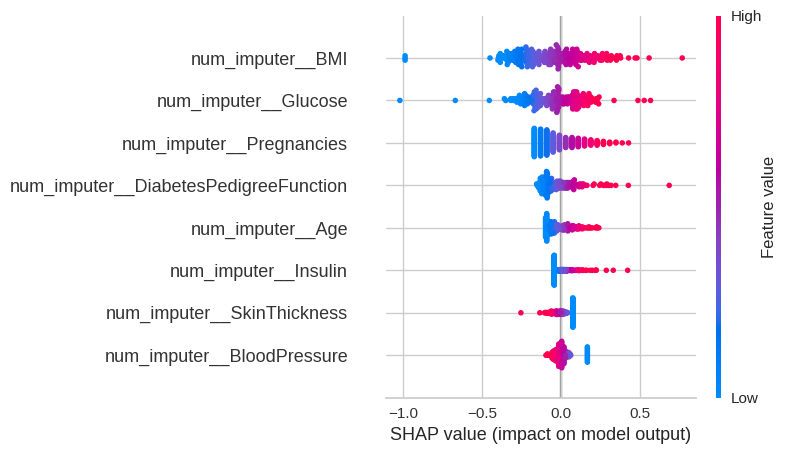

In [21]:
exp.interpret_model(best, plot='summary')

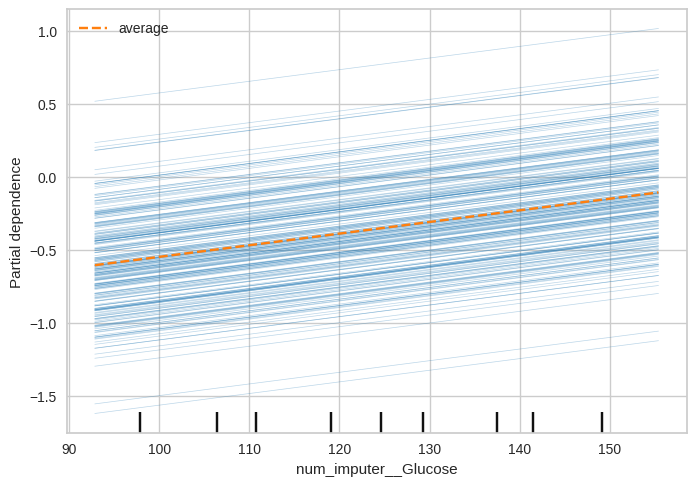

In [23]:
exp.interpret_model(best, plot='ice', feature='num_imputer__'+'Glucose')

In [26]:
data_missing_transformed = exp.pipeline.transform(data_missing)
observation1 = data_missing_transformed.drop(columns='Outcome').sample(1, random_state=40)

In [25]:
exp.interpret_model(best, plot='anchors', observation=observation1)

### Add the noise

In [27]:
data_noisy = data.copy()

noise = np.random.randint(0, 20, size=(len(data_noisy)))
data_noisy.loc[:, 'Glucose'] += noise

In [28]:
profile = ProfileReport(data, title="Pandas Profiling Report")
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [29]:
exp = ClassificationExperiment()
exp.setup(
    data_noisy,
    target='Outcome',
    session_id=42,
    n_jobs=1
)

,Description,Value
0,Session id,42
1,Target,Outcome
2,Target type,Binary
3,Original data shape,"(768, 9)"
4,Transformed data shape,"(768, 9)"
5,Transformed train set shape,"(537, 9)"
6,Transformed test set shape,"(231, 9)"
7,Numeric features,8
8,Preprocess,True
9,Imputation type,simple


In [30]:
best = exp.compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
lr,Logistic Regression,0.7820,0.8219,0.5980,0.7296,0.6479,0.4949,0.5058,0.0410
lda,Linear Discriminant Analysis,0.7727,0.8231,0.5766,0.7170,0.6297,0.4715,0.4826,0.0290
ridge,Ridge Classifier,0.7690,0.8228,0.5608,0.7177,0.6206,0.4609,0.4731,0.0150
ada,Ada Boost Classifier,0.7596,0.7960,0.5769,0.6860,0.6207,0.4484,0.4558,0.0730
et,Extra Trees Classifier,0.7543,0.8102,0.5558,0.7052,0.6079,0.4350,0.4506,0.1020
nb,Naive Bayes,0.7524,0.8109,0.5822,0.6700,0.6164,0.4365,0.4428,0.0170
catboost,CatBoost Classifier,0.7506,0.8182,0.5561,0.6813,0.6025,0.4261,0.4373,0.9620
qda,Quadratic Discriminant Analysis,0.7432,0.8089,0.5611,0.6616,0.5998,0.4142,0.4219,0.0260
gbc,Gradient Boosting Classifier,0.7412,0.8210,0.5561,0.6582,0.5933,0.4079,0.4172,0.1180
rf,Random Forest Classifier,0.7394,0.8112,0.5295,0.6711,0.5792,0.3977,0.4112,0.1370


In [ ]:
exp.evaluate_model(best)

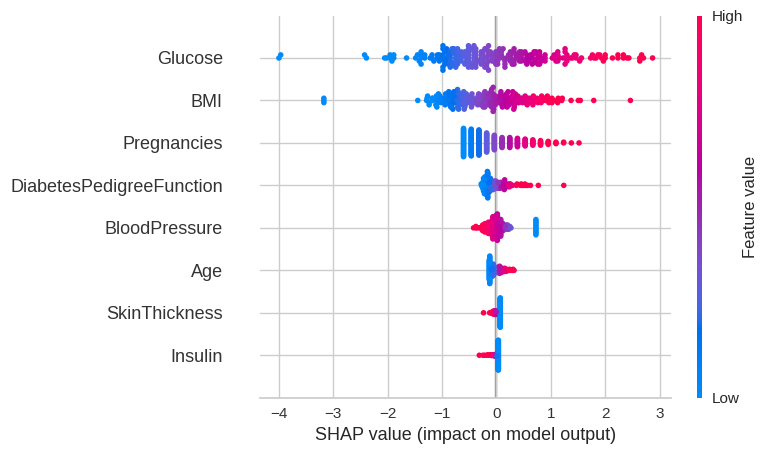

In [32]:
exp.interpret_model(best, plot='summary')

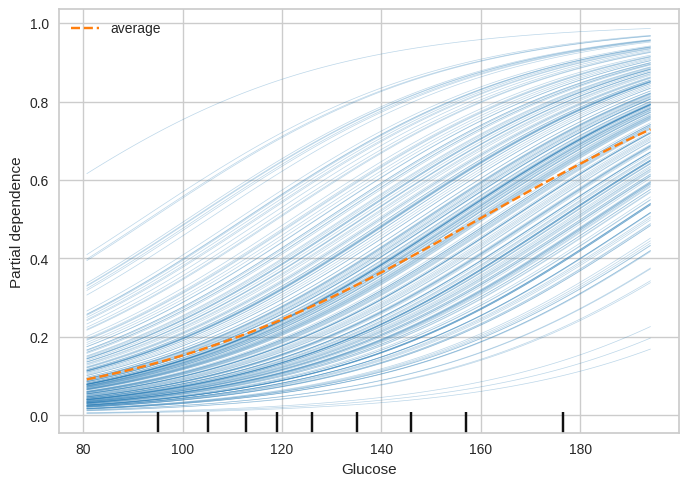

In [33]:
exp.interpret_model(best, plot='ice', feature='Glucose')